In [12]:
%matplotlib inline
import numpy as np
import cmath, math
from collections import deque
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

In [13]:
# ---------------- Parámetros ----------------
omega = 1.0
alpha0_mag = 1.5
alpha0_phase = math.pi / 6
alpha0 = alpha0_mag * cmath.exp(1j * alpha0_phase)

# Fuerza externa
drive_on = False
F0 = 0.6
nu = 1.0
kappa = 1 / math.sqrt(2.0)

# Tiempo
speed = 1.0
dt = 1 / 60.0
t = 0.0
I_drive = 0.0 + 0.0j

# Escala visual
R_world = math.sqrt(2) * abs(alpha0) + 3.0
max_pts = 2000
trail = deque(maxlen=max_pts)

In [14]:
# ---------------- Funciones ----------------
def forcing(t):
    return F0 * math.cos(nu * t)

def alpha_of_t(t, alpha0, omega, drive_on, I_drive):
    if not drive_on:
        return alpha0 * cmath.exp(-1j * omega * t)
    return cmath.exp(-1j * omega * t) * (alpha0 + kappa * I_drive)

def update_drive_integral(I_drive, t, t_next, omega):
    f_now = forcing(t)
    f_next = forcing(t_next)
    phase_now = cmath.exp(1j * omega * t)
    phase_next = cmath.exp(1j * omega * t_next)
    return I_drive + 0.5 * (phase_now * f_now + phase_next * f_next) * (t_next - t)

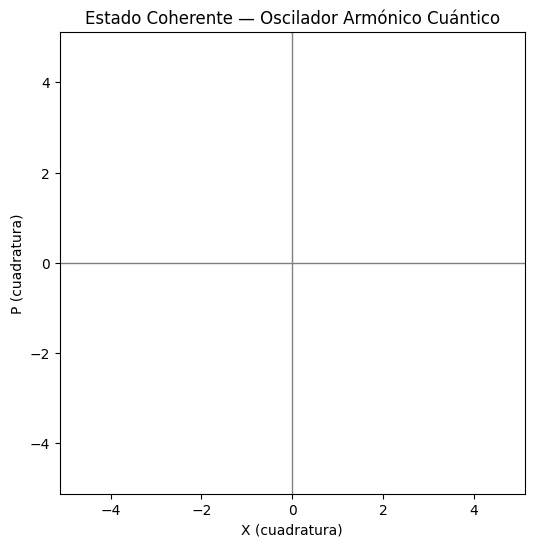

In [15]:
# ---------------- Configuración Matplotlib ----------------
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_xlim(-R_world, R_world)
ax.set_ylim(-R_world, R_world)
ax.set_xlabel("X (cuadratura)")
ax.set_ylabel("P (cuadratura)")
ax.set_title("Estado Coherente — Oscilador Armónico Cuántico")

ax.axhline(0, color='gray', lw=1)
ax.axvline(0, color='gray', lw=1)

(trail_line,) = ax.plot([], [], color='black', lw=1.2)
(point,) = ax.plot([], [], 'ro', markersize=5)
(uncertainty,) = ax.plot([], [], color='blue', lw=1.0)

In [16]:
# ---------------- Animación ----------------
def init():
    trail.clear()
    trail_line.set_data([], [])
    point.set_data([], [])
    uncertainty.set_data([], [])
    return trail_line, point, uncertainty

def animate(frame):
    global t, I_drive

    t_next = t + speed * dt
    if drive_on:
        I_drive = update_drive_integral(I_drive, t, t_next, omega)
    t = t_next

    a = alpha_of_t(t, alpha0, omega, drive_on, I_drive)
    X = math.sqrt(2.0) * a.real
    P = math.sqrt(2.0) * a.imag
    trail.append((X, P))

    if len(trail) > 1:
        xs, ys = zip(*trail)
        trail_line.set_data(xs, ys)
    point.set_data([X], [P])

    # Disco de incertidumbre
    theta = np.linspace(0, 2*np.pi, 100)
    unc_x = X + np.cos(theta)
    unc_y = P + np.sin(theta)
    uncertainty.set_data(unc_x, unc_y)

    return trail_line, point, uncertainty

# Crea la animación
anim = FuncAnimation(fig, animate, init_func=init, frames=600, interval=16, blit=True)
plt.show()

In [17]:
from IPython.display import HTML
HTML(anim.to_jshtml())